In [1]:
import os
import tweepy as tw
import pandas as pd
import numpy as np
from datetime import date
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
from numpy.linalg import norm
from scipy import stats

# Introduction: 
+ Privacy Invasion has always been a hot topic over decades. This topic is not only relevent to data scientists, but also to everyone in this Information Age.
+ There are increasing cases of internet stalker using social media information.
+ Weibo has been showing user's IP address without user's consent.
+ How easily our privacy can be invaded and how our private information can be used in good ways and bad ways?


+ With these questions, we are going to show how dangerous if our information are in bad hands. 
+ We created our own dataset by using Twitter's API, find our what information can be extracted, and how information can be used.

+ Analysis of data are based on *Similarity Analysis of Spatial-Temporal Mobility Patterns for Travel Mode Prediction Using Twitter Data*. https://ieeexplore.ieee.org/document/9294709.

# Data Collection:
+ What are we collecting?
  + It comes to our senses that geotagged tweets reveals user's specific location and time. If we can gather enough information on their tweet history, it is possible to imply a user's travel mode. 

+ Collection Method:
  + By using Twitter's API, we can extract user's information including user name, time, tweets, and more importantly, geographic information. 
More spcifically, by using the token given by Twitter, we can extract information by using tweepy package. The scrapping process has a rate limit, which makes it very slow. Also, since not every tweet is geotagged, we managed to obtain 591 different users and 65170 tweets from them with locations that falls in New York City.
  + Tweepy can only used to collect information by username or user_id, and we cannot use it direcly to search tweets that have geolocations. Also, since geotagged function can be turned off by users, it is inefficient to just random search and filter users who have geolocations. 
Therefore, we use snsscrape to search geotagged tweets day by day, and input the username comes from geotagged tweets to Tweepy for full tweet history user by user.

Search geotagged tweet by date with specific latitude and longitude. Save the usernames.

In [46]:
#import snscrape.modules.twitter as sntwitter
#import pandas as pd
#import datetime

#output_folder = ''
#keywords = 'car OR cars OR scooter OR scooters OR vehicle OR "parking" OR "private car" OR "private vehicle"'
#length = []
#counter = 0
#for start_date in start_dates:
#    since = start_date.strftime("%Y-%m-%d")
#    until = (start_date+datetime.timedelta(days=1)).strftime("%Y-%m-%d")
#    search_txt = keywords + ' since:' + since + ' until:' + until + ' geocode:"40.730610,-73.935242, 50mi" lang:en'
#    tweets_list = []
#    for i, tweet in enumerate(sntwitter.TwitterSearchScraper(search_txt).get_items()):
#        username = tweet.username
#        text = tweet.content
#        pubdate = tweet.date
#        permalink = tweet.url
#        tweets_list.append([username, text, pubdate, permalink])
#    length.append(len(tweets_list))
#    counter += 1
#    if counter % 50 == 0:
#        print(max(length))
#        length = []
#    tweets_df = pd.DataFrame(tweets_list, columns = ['username', 'text', 'date', 'link'])
#    tweets_df.to_csv(output_folder + since + '.csv')

Input usernames for Tweepy for full tweet history.

In [54]:
#auth = tw.OAuthHandler(consumer_key, consumer_secret)
#auth.set_access_token(access_token_key, access_token_secret)

#api = tw.API(auth,wait_on_rate_limit=True)

#for i in range(n): 
#    try:
#        api.user_timeline(screen_name=screen_name[i])
#    except tw.TweepError as e:
#        print(i)
#        continue
#    tweets = tw.Cursor(api.user_timeline,
#                       screen_name=screen_name[i],
#                       lang="en",
#                       since="2021-08-01",
#                       until="2022-01-01",
#                       geocode="40.730610,-73.935242,30mi",
#                       tweet_mode='extended').items(200)
#    
#    users_locs = [[tweet.user.screen_name,tweet.user.id,
#                   tweet.created_at, tweet.geo] for tweet in tweets]
    
#    tweet_text = pd.DataFrame(data=users_locs,
#                    columns=['user','user_id','date','geo']).dropna(subset=["geo"])
    
#    pd.set_option('display.max_columns', None)
#    pd.set_option('display.max_rows', None)
#    pd.set_option('display.max_colwidth', -1)
#    pd.get_option('display.width')
#    pd.set_option('display.width', 18000)
#    if i == 0:
#        tweet_text.to_csv("travel.csv", mode='a', header=True)
#    else:
#        tweet_text.to_csv("travel.csv", mode='a', header=False)
#    #tweet_text = pd.read_csv("travel.csv")
#    subway = pd.read_csv("travel.csv")
#    if i % 10 ==0:
#      print(i)
#      print(subway.user.unique().shape)

# Data Cleaning: 
+ The Data has been cleaned in R to seprate the date into spcific columns including year, month, day, and hours. 

In [1]:
df = pd.read_csv("data/twitter_users.csv")
print(df.shape)
df.head(2)

NameError: name 'pd' is not defined

We've noticed that even the program was set to find tweets that came with geographic informtaion, there are more than 20,000 tweets did not have geolocations. We drop them all.

In [56]:
df.dropna(inplace=True)
df["date"] = df["date"].apply(str)
df["date"] = df["date"].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
df.shape

(27126, 12)

The paper we are referencing calculated similarity of two people's travel pattern with Time and Space factor included. By the method proposed from paper, we will devide one day into 24 bins (by one hour), and divided space evenly 

In [57]:
df["T"] = pd.cut(df["hour"], 24, labels=list(range(0,24)))
df["Z_la"] = pd.cut(df["latitude"], 6, labels=list(range(1, 7))).astype(str)
df["Z_la"] = df["Z_la"].map(lambda x: x.rstrip('.0'))
df["Z_lon"] = pd.cut(df["longitude"], 5, labels=list(range(1, 6))).astype(str)
df["Z"] = "Z" + df["Z_la"] + "-" + df["Z_lon"]
#pd.cut(df["longitude"], 5, retbins=True)
#pd.cut(df["latitude"], 6, retbins=True)

Calcuate standard deviation of longitude and latitude for further use.

In [58]:
df["lat_std"] = df.groupby("user").latitude.transform("std")
df["lon_std"] = df.groupby("user").longitude.transform("std")
df = df.replace(np.nan, 0)
df.head(2)

,date,year,month,day,hour,minute,second,user_id,user,geo,latitude,longitude,T,Z_la,Z_lon,Z,lat_std,lon_std
0,2021-12-27,2021,12,27,11,53,59,24402703.0,MerDiann,"41.2225, -74.2897",41.2225,-74.2897,11,5,2,Z5-2,6.05522,3.702733
1,2021-11-30,2021,11,30,18,26,49,24402703.0,MerDiann,"35.9886, -78.9072",35.9886,-78.9072,18,5,2,Z5-2,6.05522,3.702733


From the data, we can see that data collectors can know precisely when the user post a tweets and where. This is scary during the process of scrapping data. After having the dataset, we want to extract more information that can be used.

# Data Visualization

In [59]:
import folium
locations = df[["latitude","longitude"]].values
map = folium.Map(location=[40.785091,	-73.968285],width="%60",height="%80", zoom_start=11)
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(map)
map

Text(0, 0.5, 'Geotagged tweets count')

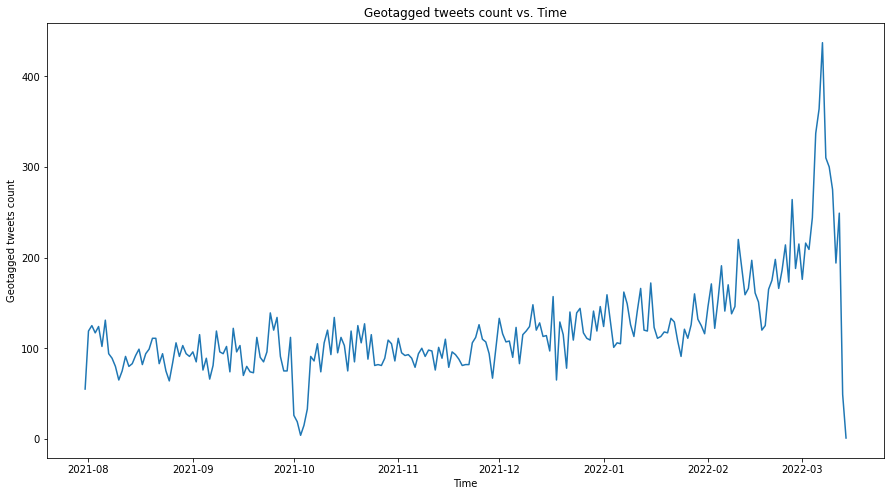

In [60]:
by_date = df.groupby("date").count()
plt.figure(figsize=(15,8))
plt.plot("year", data=by_date)
plt.title("Geotagged tweets count vs. Time")
plt.xlabel("Time")
plt.ylabel("Geotagged tweets count")

From visualization, we can see that most geolocations come from Manhattan. Number of geotagged tweets comes from the range of our search daily do not vary much, but it has an unsual peak in March

# Information Extraction:

In the paper, author proposed a prediction model that can be used to predict travel mode by using similarity to other users. We have already divided geolocations and time span into different bins. Therefore, by calculating the ratio of traveler's records falls into zone Z and time interval T, we will have the MLE for probablity of this traveler showing up in Z duing T.
With each combination of Z and T, we form a matrix that composed by probablity, denoted by S-T matrix.

With S-T matrix for each traveler, the travel mode similiarty between two of them are calculated by the formula $S_{ij} = \sum_{m=1}^T \sum_{k=1}^N \sqrt{p_{mk}^i * {p_{mk}^i}}$ ,where T is the number of Time intervals and N is the number of divided area.

As proposed in paper, we want to predict the similarity of travel modes of two people provided the information in S-T matrix. Therefore, Similarity calculated by this way will be used as label value. 

The features are:
+ Spatial Distribution Similarity (AZ):
  + Each traveler's spatial distribution vector is obtained from S-T matrix, and the similarity between two travelers is calculated by cosine similarity.
+ Temporal Distribution Similarity (AT):
  + Each traveler's temporal distribution vector obatin is from S-T matrix, and the similarity is also calculated by cosine similarity
+ Radius of gyration (AR):
  + Gyration is calculated by the standard deviation of a travel's spatial distance. Similarity of gyration is caluclated by $cl(x,y) = 1-2\times |sigmoid(x-y)-0.5|$
+ Travel frequency similarity:
  + Frequency is calculated by the ratio of number of travel records and the number of observation period. Similiarty of frequency is also calculated by $cl(x,y)$ function


In [61]:
# Similarity
def Sij(x,y):
    return np.sqrt(np.multiply(x, y)).sum().sum() 
  # return a number

def AZ(x, y):
    result = np.dot(x.sum(axis=0),y.sum(axis=0))/(norm(x.sum(axis=0)) * norm(y.sum(axis=0)))
    return result
  # return a number

def AT(x, y):
    return np.dot(x.sum(axis=1),y.sum(axis=1))/(norm(x.sum(axis=1)) * norm(y.sum(axis=1)))
  # return a number

def cl(x,y):
    return 1-2 * np.abs((1/(1+np.exp(x-y)))-0.5)
  # return a number

def gyration(name):
    x = df.loc[df['user'] == name].lat_std.values[0]
    y = df.loc[df['user'] == name].lon_std.values[0]
    result = np.sqrt(x*y)
    return result


In [62]:
# Calculate S-T matrix and the frequency
def user(name):
    zero_matrix = np.zeros((24, 22))
    rownames = list(range(0,24))
    df.Z.unique()
    temp_df = pd.DataFrame(zero_matrix, index = rownames, columns=df.Z.unique())

    num = df[(df["user"] == name)]

    # ST matrix
    ST_matrix = pd.pivot_table(num, columns = ['Z'], index = 'T', aggfunc = 'count').iloc[:, 0:len(num['Z'].unique())]
    ST_matrix.columns = ST_matrix.columns.droplevel()
    ST_matrix = ST_matrix.replace(np.nan, 0)

    freq = (ST_matrix.sum().sum())/np.sum(ST_matrix!=0).sum()

    for j in list(ST_matrix.columns):
        temp_df[j] = ST_matrix[j]
    temp_df = temp_df.replace(np.nan, 0)
    ST_matrix =  temp_df / len(num)
    return ST_matrix, freq
  # return a df and a number


Since we have 591 users, there are 134421 combinations to calculate similarity.

In [63]:
users_list = df.user.unique()
ordered_list = list(itertools.combinations(users_list,2))
print(ordered_list[1])
print(len(ordered_list))
#print(df.loc[df['user'] == "OtakusandGeeks"].lat_std.values[0])
#x = user('MerDiann')[0]
#y = user("OtakusandGeeks")[0]
#np.sum(x, axis=1)
#np.dot(x.sum(axis=0),y.sum(axis=0))/(norm(x.sum(axis=0)) * norm(y.sum(axis=0)))

('MerDiann', 'OtakusandGeeks')
134421


In [64]:
def sim_sun():
    results = []
    for (a,b) in ordered_list:
        temp_list = []
        x = user(a)[0] # ST matrix
        y = user(b)[0]

        # Similarity
        S = Sij(x,y)
  
        # Sptial distribution similarity
        ATlist = AT(x,y)

        # Temporal distribution similarity
        AZlist = AZ(x,y)

        # Radius of gyration
        m = gyration(a)
        n = gyration(b)
        AR = cl(m,n)

        # Travel frequency similarity
        freq1 = user(a)[1]
        freq2 = user(b)[1]

        AF = cl(freq1, freq2)
    
        temp_list = [S, ATlist, AZlist, AR, AF]
        results.append(temp_list)
    return results
  
#results = sim_run()

In [65]:
#similarity = pd.DataFrame(results, columns = ["Similarlity", "AT", "AZ", "AR", "AF"])

The process of calculating similarity is too long. The result has been saved as a csv file and can be read directly.

In [67]:
similarity = pd.read_csv("output/similarity.csv", names = ["index", "Similarity", "AT", "AZ", "AR", "AF"], skiprows=1)
similarity = similarity.set_index("index")

# Model Implementation:

By the paper, features are input and similarity are output. Since the input features are correlated with overall similarity(Y), the model we will be using is multivairable linear regression.

In [68]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

Y = similarity.Similarity.values
X = similarity.drop(["Similarity"], axis=1).values

In [69]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.2, random_state=123)
print(X_train.shape)
print(Y_train.shape)

(107536, 4)
(107536,)


In [72]:
import statsmodels.api as sm
#add constant to predictor variables
X = sm.add_constant(X)

#fit linear regression model
model = sm.OLS(Y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.806
Model:                            OLS   Adj. R-squared:                  0.806
Method:                 Least Squares   F-statistic:                 1.393e+05
Date:                Wed, 27 Apr 2022   Prob (F-statistic):               0.00
Time:                        20:49:04   Log-Likelihood:             1.1351e+05
No. Observations:              134421   AIC:                        -2.270e+05
Df Residuals:                  134416   BIC:                        -2.270e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.1771      0.001   -183.673      0.0

In [70]:
LR = LinearRegression().fit(X_train,Y_train)
LR.score(X_train,Y_train)

0.8055386870757699

In [71]:
LR.score(X_test, Y_test)

0.806103001398093

From the results, the $R^2$ is about $0.8$ for test dataset, which is pretty high. The model uses similarity of spatial distribution, temporal distibution, radius of gyration, travel frequency similarity to explain $80\%$ of variation in travel mode similarity. Therefore, by input two people's information, the model can successfully predict the travel mode similarity between them. All features have p-value smaller than 0.05, and we preserve them all in the model.

# Conclusion:


During the data colleting phase, we can see that a user's information can be extracted easily with Twitter's official porter. Data collector can obtain precise locations and times for users, which is great when we perform travel mode prediction because it makes prediction more accurate. The linear regression model successfully explains the variation in travel mode similarity with high $R^2$. Therefore, with a large dataset included spcific time and locations, data scientists can perform many techiniques and bring useful suggestions on travel, transportation bureauracy. They can also give suggestions to business about where and when to put advertisers. Information gives us a way to find solution efficiently. 

However, if a bad person have access to these data, he or she can predict one person's travel with a high accuracy, which is scary.  

Privacy vs. Information will always be a topic in data analysis. Data does not labeled as good or bad, but people can be labeled in this way. In previous projects, the dataset are provided directly and they are large. When it comes to large dataset, we usually look at it in a general way and try to find pattern or implement models to do something useful for a large amount of people.
But in the data collection part, we realized, if we zoom in the dataset a bit, each cases is a living person. 

